<a href="https://colab.research.google.com/github/omerbokobza/DeepQuantizationProject/blob/main/SR_GAN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import os
from PIL import Image
import matplotlib.pyplot as plt
import numpy as np
import torch
from torch.utils.data import Dataset, DataLoader
from sklearn.model_selection import train_test_split
import torch.nn as nn
from torch import nn, optim
from torch.utils.data import Dataset
from torchvision import transforms
import random
import torch.nn.functional as F
import kornia
import torchvision.transforms as T

In [ ]:
# List files in the DIV2K_train_HR directory
hr_dir = 'DIV2K/DIV2K_train_HR/DIV2K_train_HR/'
print(os.listdir(hr_dir)[:10])  # Show the first 10 files

['0298.png', '0267.png', '0501.png', '0515.png', '0273.png', '0529.png', '0703.png', '0065.png', '0071.png', '0717.png']


In [ ]:
# Set up paths for training and validation directories
train_hr_dir = 'DIV2K/DIV2K_train_HR/DIV2K_train_HR/'
valid_hr_dir = 'DIV2K/DIV2K_valid_HR/DIV2K_valid_HR/'

In [ ]:
# train_images, test_images = train_test_split(train_images, test_size=0.1, random_state=42)
# train_images
train_images = os.listdir(train_hr_dir)
val_images = os.listdir(valid_hr_dir)
print(f'Train Before Splitting: {len(train_images)}')

test_images = random.sample(train_images, 100)
train_images = [img for img in train_images if img not in test_images]

print(f'Train After Split: {len(train_images)}, Test: {len(test_images)}, Validation: {len(val_images)}')

Train Before Splitting: 800
Train After Split: 700, Test: 100, Validation: 100


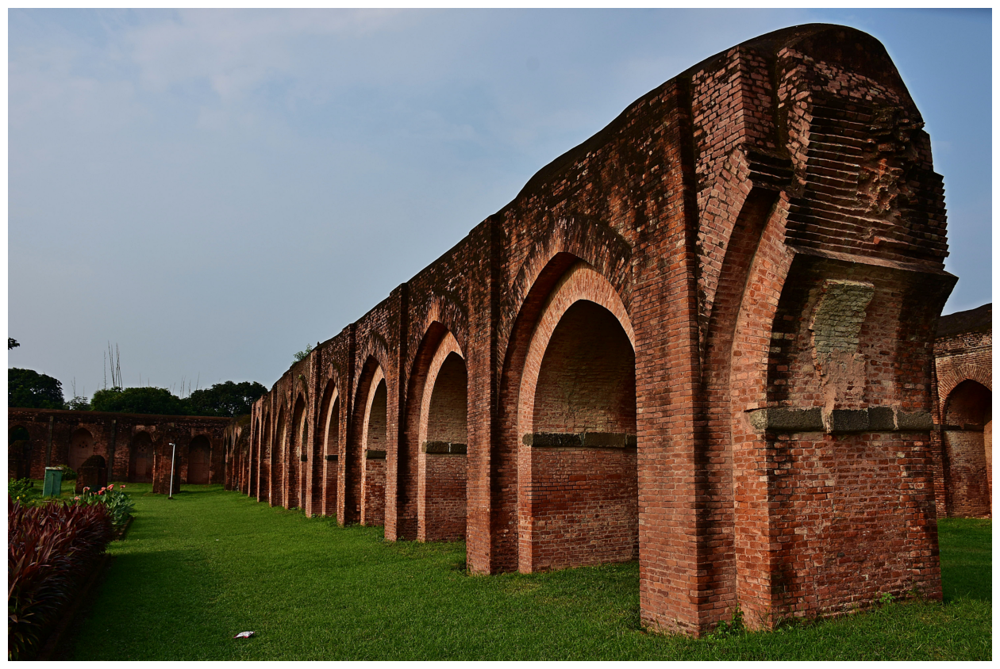

In [ ]:
# Load an example image
example_image_path = os.path.join(hr_dir, '0283.png')  # Change the filename as needed
image = Image.open(example_image_path)

# Display the image
plt.figure(figsize=(16, 16))
plt.imshow(image)
plt.axis('off')  # Hide axis labels
plt.show()

In [ ]:
print(image.size)

(2040, 1356)


In [ ]:
class DIV2KDataset(Dataset):
    def __init__(self, image_list, hr_dir, scale_factor=16, target_size=(128, 128), transform=None):
        super(DIV2KDataset, self).__init__()
        self.image_list = image_list
        self.hr_dir = hr_dir
        self.scale_factor = scale_factor
        self.target_size = target_size
        self.transform = transform

    def __len__(self):
        return len(self.image_list)

    def __getitem__(self, idx):
        # Load the high-resolution image
        image_path = os.path.join(self.hr_dir, self.image_list[idx])
        image = Image.open(image_path).convert('RGB')

        if image.size[0]<image.size[1]:
           image = image.rotate(-90, expand=True)

        # Resize HR image to the target size
        # size_1, size_2= 2040,1356
        image = image.resize(target_size, Image.BICUBIC)

        # Resize HR image to the target size
        hr_image = image.resize((image.size[0]//scale_factor, image.size[1]//scale_factor), Image.BICUBIC) # (512, 256)
        # Generate the low-resolution (LR) image by downscaling the resized HR image
        lr_image = hr_image.resize((hr_image.size[0]//scale_factor, hr_image.size[1]//scale_factor), Image.BICUBIC) # (128,64)
        hr_image = self.transform(hr_image)
        lr_image = self.transform(lr_image)

        return  lr_image, hr_image

In [ ]:
transform = transforms.Compose(
    [transforms.ToTensor(),
     transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))])
# Create datasets
scale_factor = 4
target_size = (1024,512) #int(image.size) // scale_factor

train_dataset = DIV2KDataset(train_images, train_hr_dir, scale_factor=scale_factor, target_size=target_size, transform=transform)
valid_dataset = DIV2KDataset(os.listdir(valid_hr_dir), valid_hr_dir, scale_factor=scale_factor, target_size=target_size, transform=transform)
test_dataset = DIV2KDataset(test_images, train_hr_dir, scale_factor=scale_factor, target_size=target_size, transform=transform)

# Create DataLoaders
train_loader = DataLoader(train_dataset, batch_size=16, shuffle=True, num_workers=0)
valid_loader = DataLoader(valid_dataset, batch_size=16, shuffle=False, num_workers=0)
test_loader = DataLoader(test_dataset, batch_size=16, shuffle=False, num_workers=0)

In [ ]:
for lr_imgs, hr_imgs in train_loader:
    print(f"Low-resolution images batch shape: {lr_imgs.shape}")
    print(f"High-resolution images batch shape: {hr_imgs.shape}")
    break


Low-resolution images batch shape: torch.Size([16, 3, 32, 64])
High-resolution images batch shape: torch.Size([16, 3, 128, 256])


Low-resolution image size: (64, 32)
High-resolution image size: (256, 128)


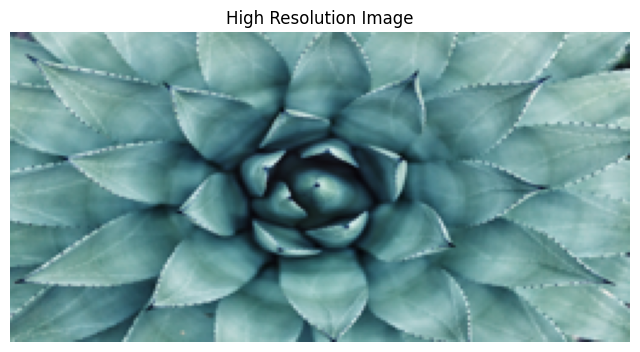

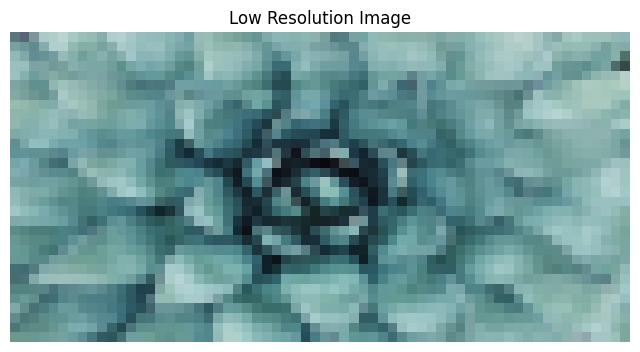

In [ ]:
# Define the inverse normalization transformation
inverse_transform = transforms.Compose([
    transforms.Normalize((-1, -1, -1), (2, 2, 2)),  # Undo the normalization
    transforms.ToPILImage()  # Convert back to a PIL image
])

# Assuming lr_image and hr_image are from the DataLoader
for lr_images, hr_images in train_loader:
    # Take the first image from the batch
    lr_image = lr_images[0]
    hr_image = hr_images[0]
    #
    # Un-normalize and convert to PIL image
    lr_image_pil = inverse_transform(lr_image)
    hr_image_pil = inverse_transform(hr_image)

    # Display the images
    print(f"Low-resolution image size: {lr_image_pil.size}")
    print(f"High-resolution image size: {hr_image_pil.size}")

    plt.figure(figsize=(8, 8))
    plt.title("High Resolution Image")
    plt.imshow(hr_image_pil)
    plt.axis('off')
    plt.show()

    plt.figure(figsize=(8, 8))
    plt.title("Low Resolution Image")
    plt.imshow(lr_image_pil)
    plt.axis('off')
    plt.show()

    break  # Display only the first batch


## Models

GAN MODEL:

In [ ]:
class GeneratorResBlock(nn.Module):
    def __init__(self, in_channels):
        super(GeneratorResBlock, self).__init__()
        self.conv1 = nn.Conv2d(in_channels, in_channels, kernel_size=3, padding=1)
        self.relu = nn.ReLU(inplace=True)
        self.conv2 = nn.Conv2d(in_channels, in_channels, kernel_size=3, padding=1)

    def forward(self, x):
        residual = x
        x = self.relu(self.conv1(x))
        x = self.conv2(x)
        x += residual
        return x

class SRGAN_Generator(nn.Module):
    def __init__(self, num_res_blocks=16, upscale_factor=4):
        super(SRGAN_Generator, self).__init__()
        self.conv1 = nn.Conv2d(3, 64, kernel_size=9, padding=4)
        self.relu = nn.ReLU()

        layers = []
        for _ in range(num_res_blocks):
            layers.append(GeneratorResBlock(64))
        self.res_blocks = nn.Sequential(*layers)

        self.conv2 = nn.Conv2d(64, 64, kernel_size=3, padding=1)

        # Adjusting upsampling layers for desired output size
        upsample_layers = []
        for _ in range(int(upscale_factor/2)):
            upsample_layers.append(nn.Conv2d(64, 256, kernel_size=3, padding=1))
            upsample_layers.append(nn.PixelShuffle(2))  # Upscale by a factor of 2
            upsample_layers.append(nn.ReLU())

        self.upsample = nn.Sequential(*upsample_layers)

        self.conv3 = nn.Conv2d(64, 3, kernel_size=9, padding=4)

    def forward(self, x):
        x = self.relu(self.conv1(x))
        x = self.res_blocks(x)
        x = self.conv2(x)
        x = self.upsample(x)
        x = self.conv3(x)
        return x

# # Example usage
# generator = SRGAN_Generator(upscale_factor=4)
# lr_image = torch.randn(1, 3, 32, 64)  # Example low-resolution image
# hr_image = generator(lr_image)
# print(f"Generated HR image size: {hr_image.shape}")

In [ ]:
class SRGAN_Discriminator(nn.Module):
    def __init__(self, input_shape=(3, 128, 256)):
        super(SRGAN_Discriminator, self).__init__()
        self.conv1 = nn.Conv2d(3, 64, kernel_size=3, stride=1, padding=1)
        self.leaky_relu = nn.LeakyReLU(0.2)

        # Convolutional layers
        self.layers = nn.Sequential(
            nn.Conv2d(64, 64, kernel_size=3, stride=2, padding=1),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(0.2),
            nn.Conv2d(64, 128, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2),
            nn.Conv2d(128, 128, kernel_size=3, stride=2, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2),
            nn.Conv2d(128, 256, kernel_size=3, stride=2, padding=1),  # Additional conv layer
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2),
        )

        # Calculate the flattened size dynamically
        with torch.no_grad():
            self._flattened_size = self._calculate_flattened_size(input_shape)

        # Fully connected layers with fewer neurons
        self.fc = nn.Sequential(
            nn.Flatten(),
            nn.Linear(self._flattened_size, 512),  # Reduced size
            nn.LeakyReLU(0.2),
            nn.Linear(512, 1),
            nn.Sigmoid()
        )

    def _calculate_flattened_size(self, input_shape):
        # Create a dummy input tensor with the same shape as the real input
        dummy_input = torch.zeros(1, *input_shape)
        dummy_output = self.leaky_relu(self.conv1(dummy_input))
        dummy_output = self.layers(dummy_output)
        # Return the flattened size
        return dummy_output.numel()

    def forward(self, x):
        x = self.leaky_relu(self.conv1(x))
        x = self.layers(x)
        x = self.fc(x)
        return x

# # Example usage
# input_shape = (3, 128, 256)
# discriminator = SRGAN_Discriminator(input_shape=input_shape)
# hr_image = torch.randn(1, 3, 128, 256)  # Example high-resolution image
# output = discriminator(hr_image)
# print(f"Discriminator output: {output.shape}")

In [ ]:
class SimpleDiffusionModel(nn.Module):
    def __init__(self, in_channels=3, base_channels=64):
        super(SimpleDiffusionModel, self).__init__()
        self.encoder = nn.Sequential(
            nn.Conv2d(in_channels, base_channels, 3, stride=2, padding=1),
            nn.ReLU(),
            nn.Conv2d(base_channels, base_channels*2, 3, stride=2, padding=1),
            nn.ReLU(),
        )
        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(base_channels*2, base_channels, 3, stride=2, padding=1, output_padding=1),
            nn.ReLU(),
            nn.ConvTranspose2d(base_channels, in_channels, 3, stride=2, padding=1, output_padding=1),
            nn.Tanh(),
        )

    def forward(self, x):
        encoded = self.encoder(x)
        decoded = self.decoder(encoded)
        return decoded

diffusion_model = SimpleDiffusionModel()

class DiffusionSuperResolutionModel(nn.Module):
    def __init__(self, in_channels=3, base_channels=64, num_steps=4):
        super(DiffusionSuperResolutionModel, self).__init__()
        self.num_steps = num_steps
        self.initial_conv = nn.Conv2d(in_channels, base_channels, 3, stride=1, padding=1)
        self.relus = nn.ModuleList([nn.ReLU() for _ in range(num_steps)])
        self.convs = nn.ModuleList([nn.Conv2d(base_channels, base_channels, 3, stride=1, padding=1) for _ in range(num_steps)])
        self.final_conv = nn.Conv2d(base_channels, in_channels, 3, stride=1, padding=1)

    def forward(self, x):
        x = self.initial_conv(x)
        for i in range(self.num_steps):
            x = self.relus[i](self.convs[i](x))
        x = self.final_conv(x)
        return x

diffusion_sr_model = DiffusionSuperResolutionModel()



In [ ]:
def save_checkpoint(model, epoch, val_loss, name_for_checkpoints, checkpoint_dir='checkpoints'):
    os.makedirs(checkpoint_dir, exist_ok=True)
    checkpoint_filename = f'{name_for_checkpoints}_epoch_{epoch+1}_val_loss_{val_loss:.4f}.pth'
    checkpoint_path = os.path.join(checkpoint_dir, checkpoint_filename)
    torch.save(model.state_dict(), checkpoint_path)
    print(f"Checkpoint saved: {checkpoint_path}")

In [ ]:
def train_srgans(generator, discriminator, train_loader, valid_loader, criterion, optimizer_g, optimizer_d, num_epochs=20, device='cuda', name_for_checkpoints=None):
    generator = generator.to(device)
    discriminator = discriminator.to(device)
    best_val_loss = float('inf')

    train_g_losses = []
    train_d_losses = []
    val_losses = []

    for epoch in range(num_epochs):
        print(f'Epoch {epoch+1}/{num_epochs}...')

        # Training Phase
        generator.train()
        discriminator.train()
        train_g_loss = 0.0
        train_d_loss = 0.0

        for lr_imgs, hr_imgs in train_loader:
            lr_imgs, hr_imgs = lr_imgs.to(device), hr_imgs.to(device)

            # Train Discriminator
            optimizer_d.zero_grad()

            # Generate high-resolution images from low-resolution images
            fake_hr_imgs = generator(lr_imgs)

            # Real images, label = 1
            real_outputs = discriminator(hr_imgs)
            real_labels = torch.ones_like(real_outputs).to(device)
            loss_real = criterion(real_outputs, real_labels)

            # Fake images, label = 0
            fake_outputs = discriminator(fake_hr_imgs.detach())
            fake_labels = torch.zeros_like(fake_outputs).to(device)
            loss_fake = criterion(fake_outputs, fake_labels)

            # Total discriminator loss
            d_loss = loss_real + loss_fake
            train_d_loss += d_loss.item()

            d_loss.backward()
            optimizer_d.step()

            # Train Generator
            optimizer_g.zero_grad()

            # Adversarial loss
            fake_outputs = discriminator(fake_hr_imgs)
            g_adv_loss = criterion(fake_outputs, real_labels)

            # Content loss (Mean Squared Error between generated and real HR images)
            content_loss = criterion(fake_hr_imgs, hr_imgs)

            # Total generator loss
            g_loss = content_loss + 1e-3 * g_adv_loss  # Adversarial loss is often scaled down
            train_g_loss += g_loss.item()

            g_loss.backward()
            optimizer_g.step()

        avg_train_g_loss = train_g_loss / len(train_loader)
        avg_train_d_loss = train_d_loss / len(train_loader)
        train_g_losses.append(avg_train_g_loss)
        train_d_losses.append(avg_train_d_loss)
        print(f'Epoch [{epoch+1}/{num_epochs}], Train Generator Loss: {avg_train_g_loss:.4f}, Train Discriminator Loss: {avg_train_d_loss:.4f}')

        # Validation Phase
        generator.eval()
        with torch.no_grad():
            val_loss = 0.0
            for lr_imgs, hr_imgs in valid_loader:
                lr_imgs, hr_imgs = lr_imgs.to(device), hr_imgs.to(device)
                fake_hr_imgs = generator(lr_imgs)
                val_loss += criterion(fake_hr_imgs, hr_imgs).item()

        avg_val_loss = val_loss / len(valid_loader)
        val_losses.append(avg_val_loss)
        print(f"Epoch [{epoch+1}/{num_epochs}], Validation Loss: {avg_val_loss:.4f}")

        # Save checkpoint if it's the best model so far
        if avg_val_loss < best_val_loss:
            best_val_loss = avg_val_loss
            save_checkpoint(generator, epoch, avg_val_loss, name_for_checkpoints)

    # Plot training and validation loss
    plt.figure()
    plt.plot(range(1, num_epochs + 1), train_g_losses, label='Train Generator Loss')
    plt.plot(range(1, num_epochs + 1), train_d_losses, label='Train Discriminator Loss')
    plt.plot(range(1, num_epochs + 1), val_losses, label='Validation Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.title('Training and Validation Loss Over Epochs')
    plt.legend()
    plt.show()

    return generator



In [ ]:
device = torch.device("mps" if torch.backends.mps.is_available() else "cpu")
print(device)

mps


Epoch 1/20...
Epoch [1/20], Train Generator Loss: 0.1680, Train Discriminator Loss: 0.0818
Epoch [1/20], Validation Loss: 0.0975
Checkpoint saved: checkpoints/srgan_epoch_1_val_loss_0.0975.pth
Epoch 2/20...
Epoch [2/20], Train Generator Loss: 0.0761, Train Discriminator Loss: 0.0580
Epoch [2/20], Validation Loss: 0.0731
Checkpoint saved: checkpoints/srgan_epoch_2_val_loss_0.0731.pth
Epoch 3/20...
Epoch [3/20], Train Generator Loss: 0.0630, Train Discriminator Loss: 0.0288
Epoch [3/20], Validation Loss: 0.0638
Checkpoint saved: checkpoints/srgan_epoch_3_val_loss_0.0638.pth
Epoch 4/20...
Epoch [4/20], Train Generator Loss: 0.0554, Train Discriminator Loss: 0.0028
Epoch [4/20], Validation Loss: 0.0576
Checkpoint saved: checkpoints/srgan_epoch_4_val_loss_0.0576.pth
Epoch 5/20...
Epoch [5/20], Train Generator Loss: 0.0507, Train Discriminator Loss: 0.0106
Epoch [5/20], Validation Loss: 0.0551
Checkpoint saved: checkpoints/srgan_epoch_5_val_loss_0.0551.pth
Epoch 6/20...
Epoch [6/20], Train G

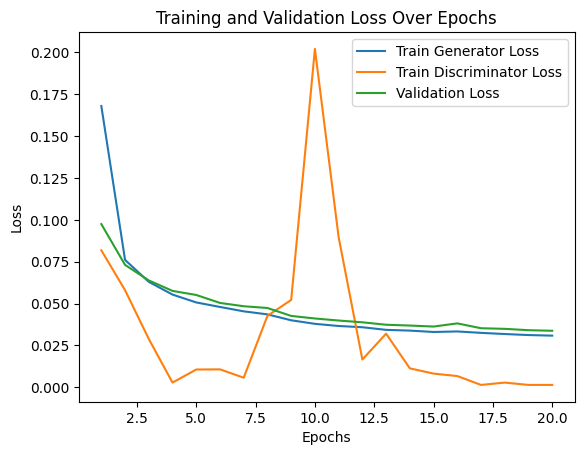

In [ ]:
# Instantiate the model, loss function, and optimizer
name_for_checkpoints = ['srgan']
generator = SRGAN_Generator()
discriminator = SRGAN_Discriminator()
criterion = nn.BCELoss()  # Binary Cross-Entropy for GAN
content_criterion = nn.MSELoss()  # Content loss (could also use perceptual loss)

optimizer_g = optim.Adam(generator.parameters(), lr=1e-4)
optimizer_d = optim.Adam(discriminator.parameters(), lr=1e-4)

# Train the SRGAN
trained_generator = train_srgans(
    generator=generator,
    discriminator=discriminator,
    train_loader=train_loader,
    valid_loader=valid_loader,
    criterion=content_criterion,
    optimizer_g=optimizer_g,
    optimizer_d=optimizer_d,
    num_epochs=20,
    device=device,
    name_for_checkpoints= name_for_checkpoints[0]
)

# Evaluation

In [ ]:
def calculate_psnr(output, target):
    mse = F.mse_loss(output, target)
    psnr = 10 * torch.log10(1 / mse)  # assuming images are normalized between [0, 1]
    return psnr.item()

In [ ]:
# def calculate_ssim(output, target):
#     # SSIM expects images to be in range [0, 1]
#     output = output.clamp(0, 1)
#     target = target.clamp(0, 1)
#
#     # Calculate SSIM
#     ssim_value = kornia.metrics.ssim(output, target, window_size=11).mean()
#     return ssim_value.item()
#
# def calculate_mssim(output, target, max_val=1.0):
#     # Ensure the images are clamped to the range [0, 1]
#     output = output.clamp(0, 1)
#     target = target.clamp(0, 1)
#
#     # Calculate MSSIM at multiple scales
#     mssim_value = kornia.metrics.msssim(output, target, max_val=max_val)
#
#     return mssim_value.item()
# # Example usage
# output = torch.rand(1, 3, 256, 256)  # Replace with your model output
# target = torch.rand(1, 3, 256, 256)  # Replace with your target image
# ssim_value = calculate_ssim(output, target)
# print(f"SSIM: {ssim_value}")


def gaussian(window_size, sigma, device):
    gauss = torch.tensor([torch.exp(torch.tensor(-(x - window_size//2)**2 / float(2*sigma**2))) for x in range(window_size)], device=device)
    return gauss / gauss.sum()

def create_window(window_size, channel, device):
    _1D_window = gaussian(window_size, 1.5, device).unsqueeze(1)
    _2D_window = _1D_window.mm(_1D_window.t()).float().unsqueeze(0).unsqueeze(0)
    window = _2D_window.expand(channel, 1, window_size, window_size).contiguous()
    return window


def _ssim(img1, img2, window, window_size, channel, size_average=True):
    mu1 = F.conv2d(img1, window, padding=window_size//2, groups=channel)
    mu2 = F.conv2d(img2, window, padding=window_size//2, groups=channel)

    mu1_sq = mu1.pow(2)
    mu2_sq = mu2.pow(2)
    mu1_mu2 = mu1 * mu2

    sigma1_sq = F.conv2d(img1 * img1, window, padding=window_size//2, groups=channel) - mu1_sq
    sigma2_sq = F.conv2d(img2 * img2, window, padding=window_size//2, groups=channel) - mu2_sq
    sigma12 = F.conv2d(img1 * img2, window, padding=window_size//2, groups=channel) - mu1_mu2

    C1 = 0.01 ** 2
    C2 = 0.03 ** 2

    ssim_map = ((2 * mu1_mu2 + C1) * (2 * sigma12 + C2)) / ((mu1_sq + mu2_sq + C1) * (sigma1_sq + sigma2_sq + C2))

    if size_average:
        return ssim_map.mean()
    else:
        return ssim_map.mean(1).mean(1).mean(1)

def ssim(img1, img2, window_size=11, size_average=True):
    (_, channel, _, _) = img1.size()
    device = img1.device
    window = create_window(window_size, channel, device)

    return _ssim(img1, img2, window, window_size, channel, size_average)

def msssim(img1, img2, window_size=11, size_average=True):
    weights = torch.FloatTensor([0.0448, 0.2856, 0.3001, 0.2363, 0.1333]).to(img1.device)
    levels = weights.size()[0]
    mssim = []

    for _ in range(levels):
        ssim_map = ssim(img1, img2, window_size, size_average)
        mssim.append(ssim_map)

        if img1.size(2) == 1 or img1.size(3) == 1:
            break

        img1 = F.avg_pool2d(img1, (2, 2))
        img2 = F.avg_pool2d(img2, (2, 2))

    mssim = torch.stack(mssim)
    return (mssim * weights).sum()


In [ ]:
def evaluate_model_with_mssim(model, test_loader, device='mps'):
    model.eval()
    avg_psnr = 0.0
    avg_ssim = 0.0
    avg_mssim = 0.0
    num_batches = len(test_loader)

    with torch.no_grad():
        for lr_imgs, hr_imgs in test_loader:
            lr_imgs, hr_imgs = lr_imgs.to(device), hr_imgs.to(device)
            outputs = model(lr_imgs)

            # Calculate PSNR, SSIM, and MSSIM
            psnr_value = calculate_psnr(outputs, hr_imgs)
            ssim_value = calculate_ssim(outputs, hr_imgs)
            mssim_value = msssim(outputs, hr_imgs)

            avg_psnr += psnr_value
            avg_ssim += ssim_value
            avg_mssim += mssim_value

    avg_psnr /= num_batches
    avg_ssim /= num_batches
    avg_mssim /= num_batches

    print(f'Average PSNR: {avg_psnr:.4f} dB')
    print(f'Average SSIM: {avg_ssim:.4f}')
    print(f'Average MSSIM: {avg_mssim:.4f}')

    return avg_psnr, avg_ssim, avg_mssim

# Evaluate your trained model on the test set
evaluate_model_with_mssim(trained_generator, test_loader, device=device)


Average PSNR: 15.3295 dB
Average SSIM: 0.6609
Average MSSIM: 0.8759


(15.329548018319267, 0.6609028152057103, tensor(0.8759, device='mps:0'))

The size of the High-res id: (256, 128)
The size of the Trained-res id: (256, 128)
The size of the Low-res id: (64, 32)


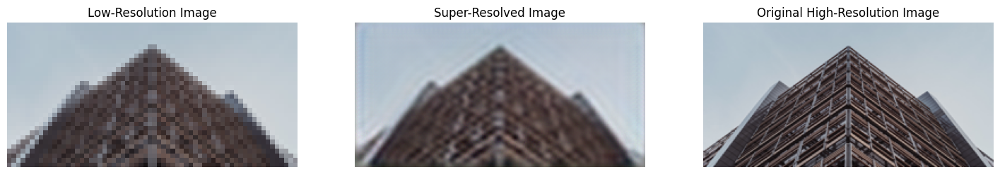

The size of the High-res id: (256, 128)
The size of the Trained-res id: (256, 128)
The size of the Low-res id: (64, 32)


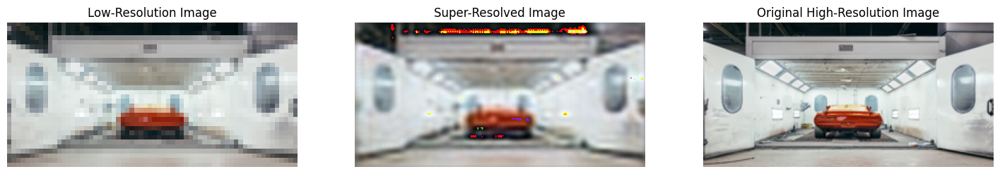

The size of the High-res id: (256, 128)
The size of the Trained-res id: (256, 128)
The size of the Low-res id: (64, 32)


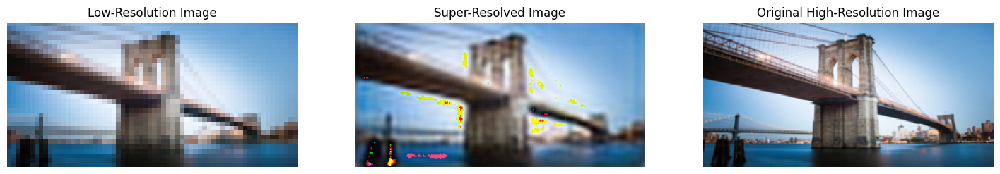

The size of the High-res id: (256, 128)
The size of the Trained-res id: (256, 128)
The size of the Low-res id: (64, 32)


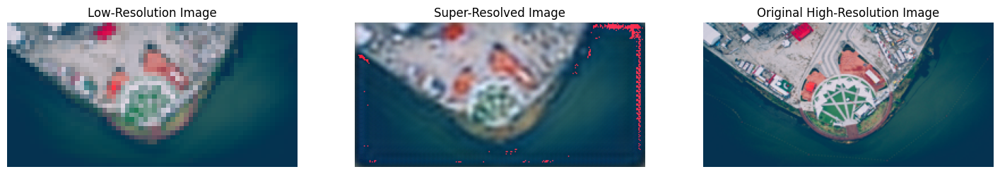

The size of the High-res id: (256, 128)
The size of the Trained-res id: (256, 128)
The size of the Low-res id: (64, 32)


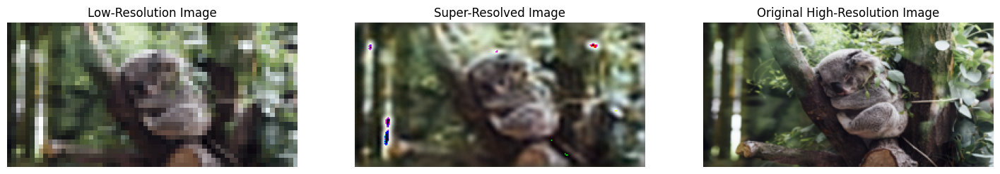

The size of the High-res id: (256, 128)
The size of the Trained-res id: (256, 128)
The size of the Low-res id: (64, 32)


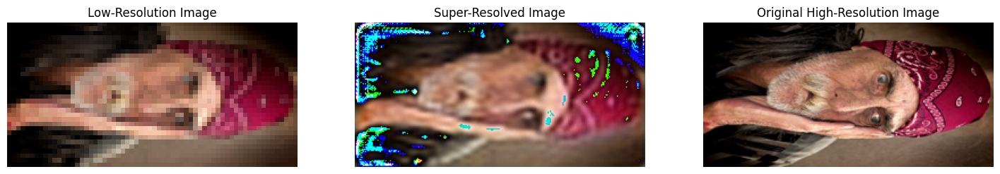

The size of the High-res id: (256, 128)
The size of the Trained-res id: (256, 128)
The size of the Low-res id: (64, 32)


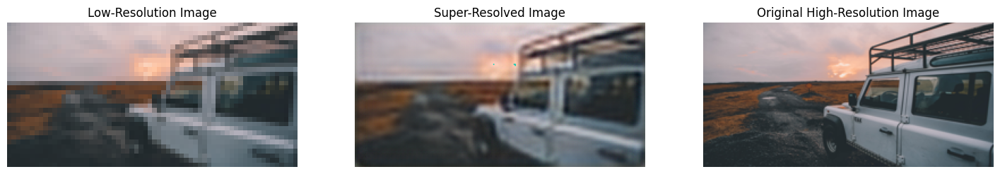

The size of the High-res id: (256, 128)
The size of the Trained-res id: (256, 128)
The size of the Low-res id: (64, 32)


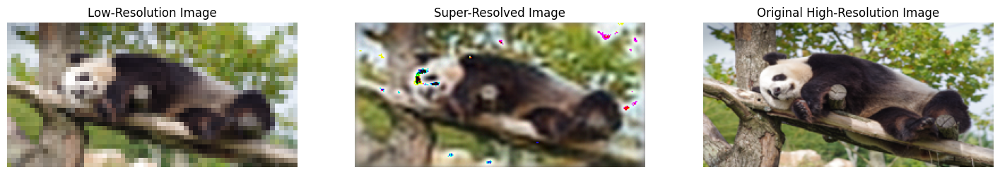

The size of the High-res id: (256, 128)
The size of the Trained-res id: (256, 128)
The size of the Low-res id: (64, 32)


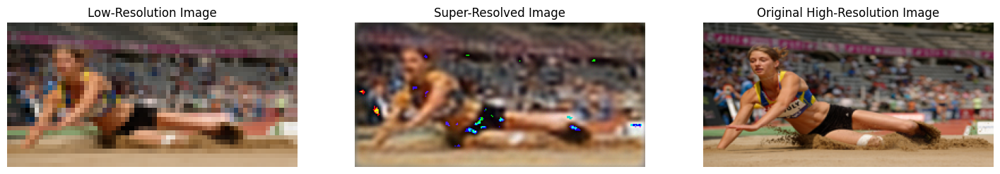

The size of the High-res id: (256, 128)
The size of the Trained-res id: (256, 128)
The size of the Low-res id: (64, 32)


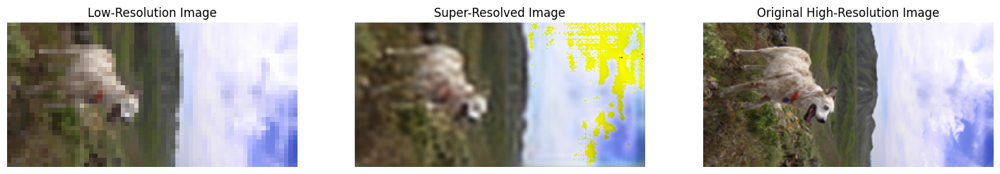

The size of the High-res id: (256, 128)
The size of the Trained-res id: (256, 128)
The size of the Low-res id: (64, 32)


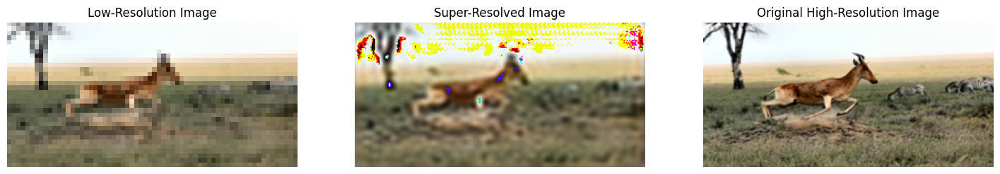

The size of the High-res id: (256, 128)
The size of the Trained-res id: (256, 128)
The size of the Low-res id: (64, 32)


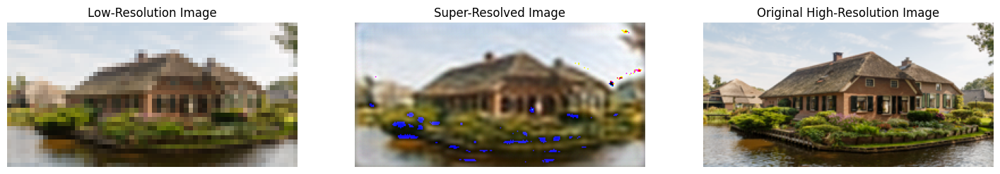

The size of the High-res id: (256, 128)
The size of the Trained-res id: (256, 128)
The size of the Low-res id: (64, 32)


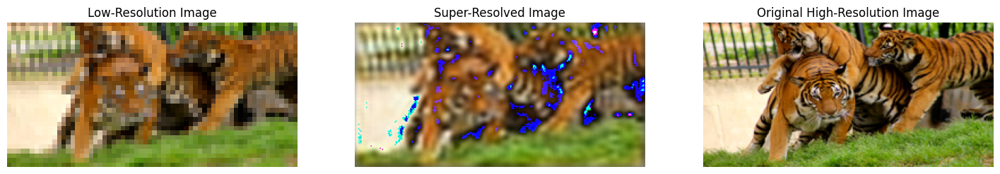

The size of the High-res id: (256, 128)
The size of the Trained-res id: (256, 128)
The size of the Low-res id: (64, 32)


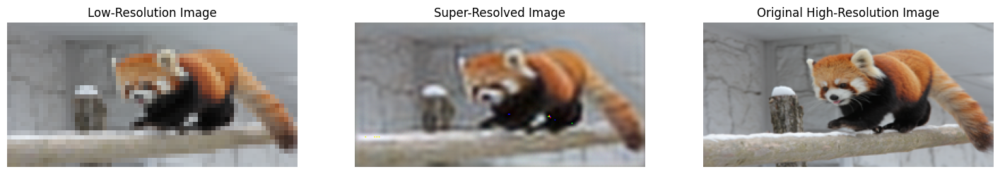

The size of the High-res id: (256, 128)
The size of the Trained-res id: (256, 128)
The size of the Low-res id: (64, 32)


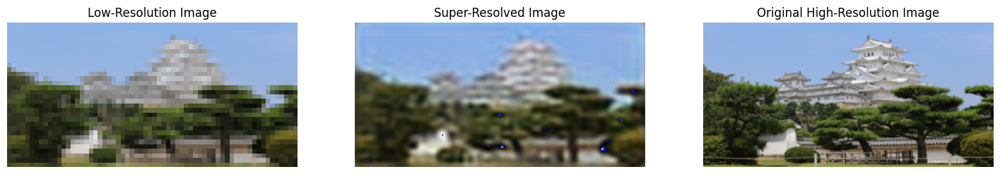

The size of the High-res id: (256, 128)
The size of the Trained-res id: (256, 128)
The size of the Low-res id: (64, 32)


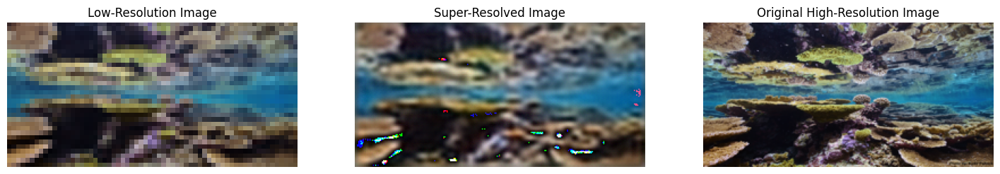

The size of the High-res id: (256, 128)
The size of the Trained-res id: (256, 128)
The size of the Low-res id: (64, 32)


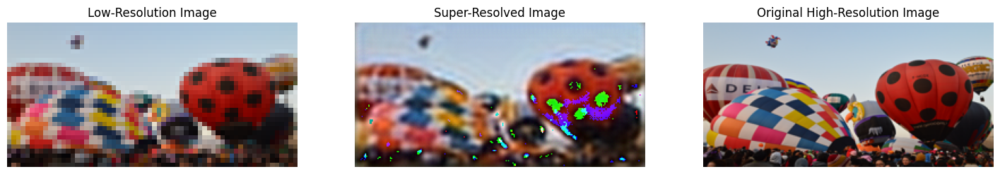

The size of the High-res id: (256, 128)
The size of the Trained-res id: (256, 128)
The size of the Low-res id: (64, 32)


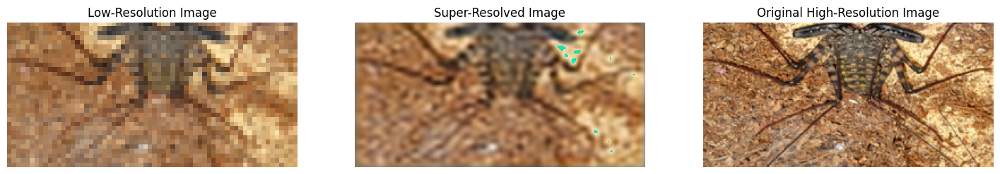

The size of the High-res id: (256, 128)
The size of the Trained-res id: (256, 128)
The size of the Low-res id: (64, 32)


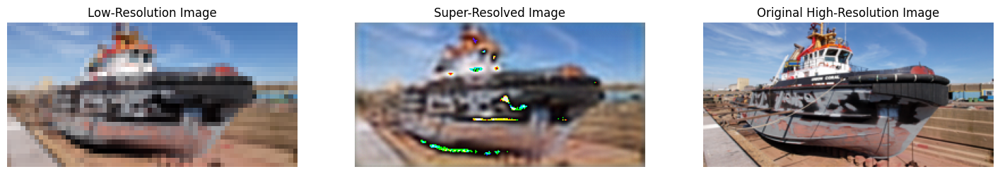

The size of the High-res id: (256, 128)
The size of the Trained-res id: (256, 128)
The size of the Low-res id: (64, 32)


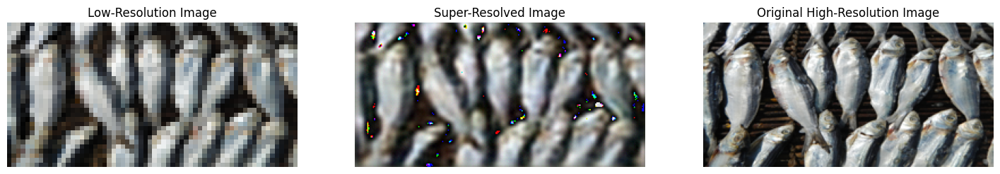

The size of the High-res id: (256, 128)
The size of the Trained-res id: (256, 128)
The size of the Low-res id: (64, 32)


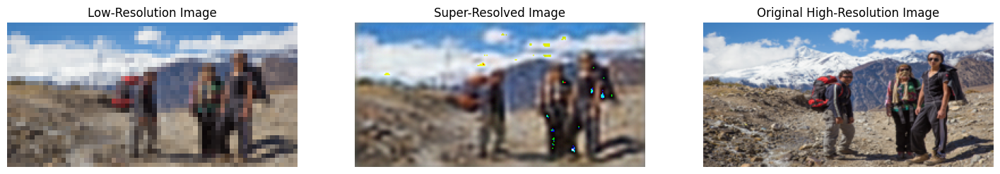

The size of the High-res id: (256, 128)
The size of the Trained-res id: (256, 128)
The size of the Low-res id: (64, 32)


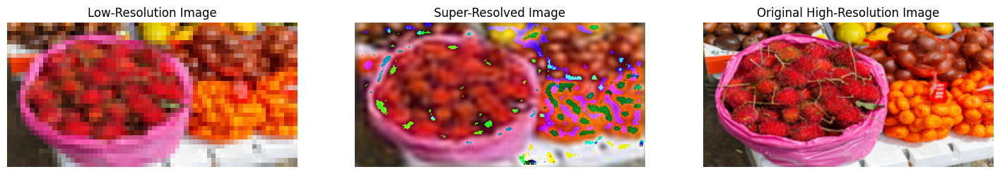

The size of the High-res id: (256, 128)
The size of the Trained-res id: (256, 128)
The size of the Low-res id: (64, 32)


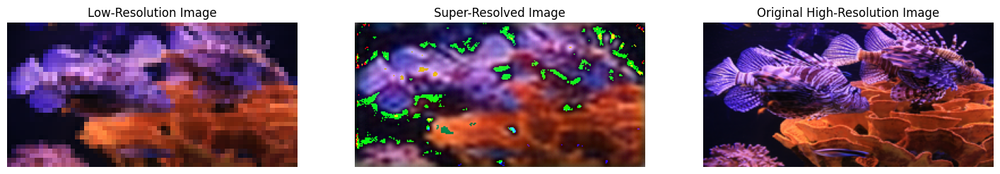

The size of the High-res id: (256, 128)
The size of the Trained-res id: (256, 128)
The size of the Low-res id: (64, 32)


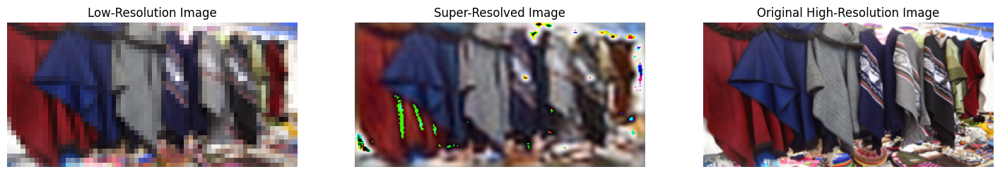

The size of the High-res id: (256, 128)
The size of the Trained-res id: (256, 128)
The size of the Low-res id: (64, 32)


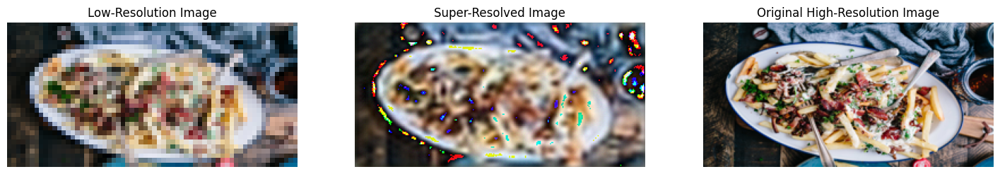

The size of the High-res id: (256, 128)
The size of the Trained-res id: (256, 128)
The size of the Low-res id: (64, 32)


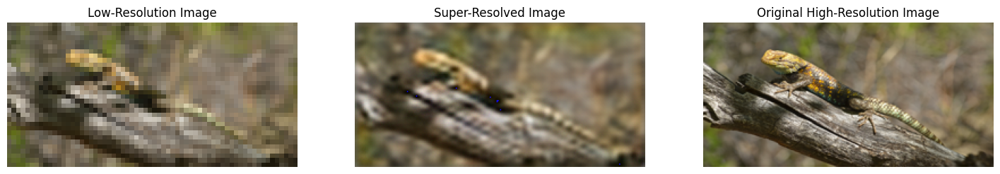

The size of the High-res id: (256, 128)
The size of the Trained-res id: (256, 128)
The size of the Low-res id: (64, 32)


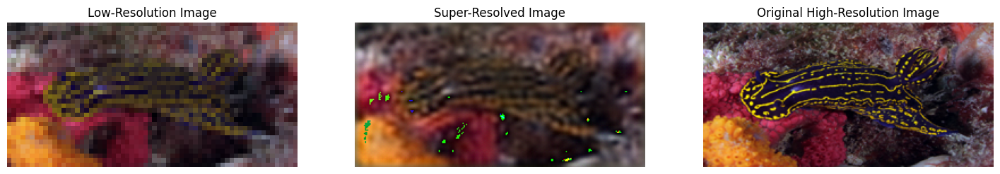

The size of the High-res id: (256, 128)
The size of the Trained-res id: (256, 128)
The size of the Low-res id: (64, 32)


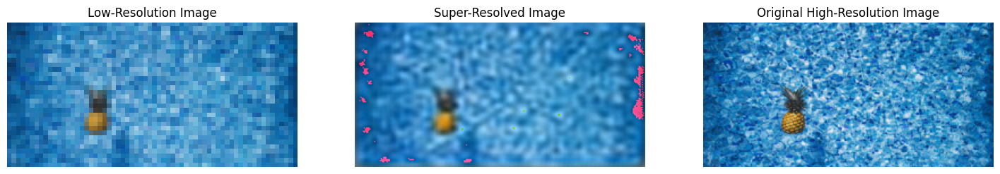

The size of the High-res id: (256, 128)
The size of the Trained-res id: (256, 128)
The size of the Low-res id: (64, 32)


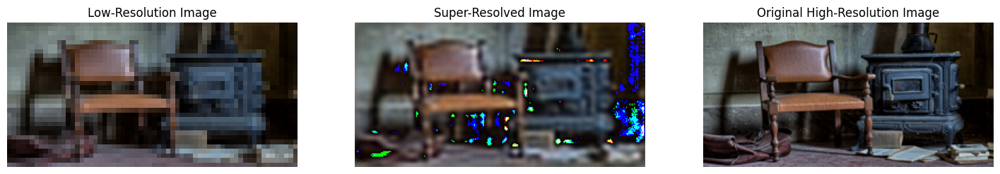

The size of the High-res id: (256, 128)
The size of the Trained-res id: (256, 128)
The size of the Low-res id: (64, 32)


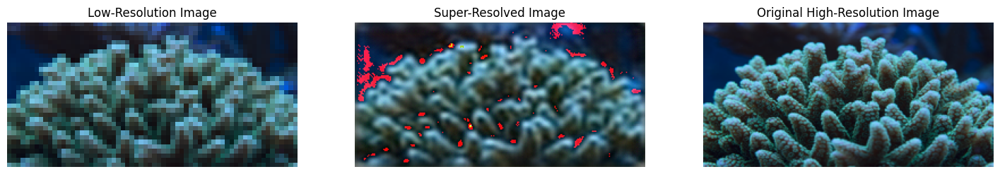

The size of the High-res id: (256, 128)
The size of the Trained-res id: (256, 128)
The size of the Low-res id: (64, 32)


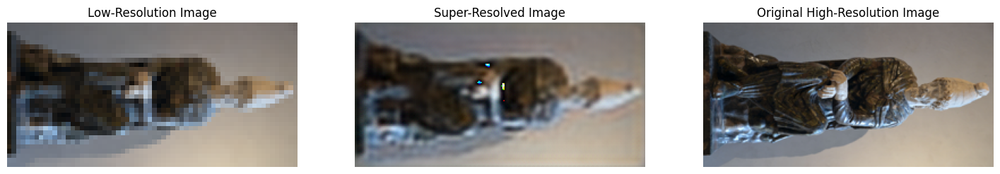

The size of the High-res id: (256, 128)
The size of the Trained-res id: (256, 128)
The size of the Low-res id: (64, 32)


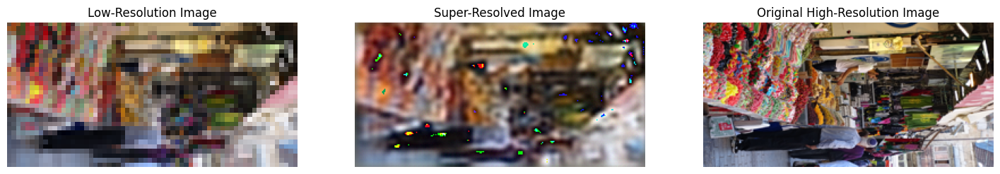

The size of the High-res id: (256, 128)
The size of the Trained-res id: (256, 128)
The size of the Low-res id: (64, 32)


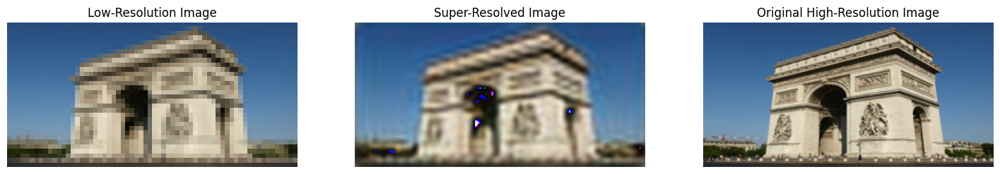

The size of the High-res id: (256, 128)
The size of the Trained-res id: (256, 128)
The size of the Low-res id: (64, 32)


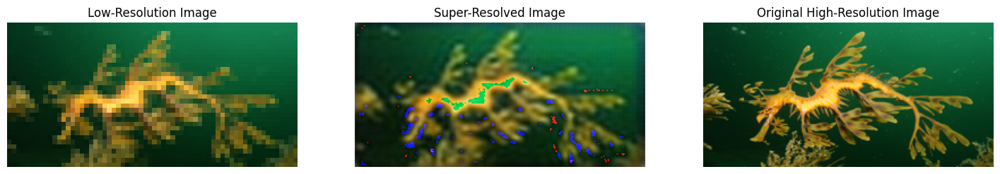

The size of the High-res id: (256, 128)
The size of the Trained-res id: (256, 128)
The size of the Low-res id: (64, 32)


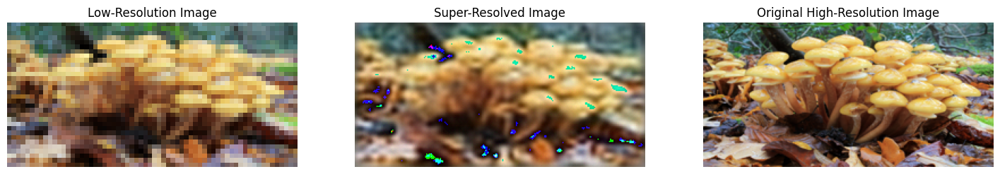

The size of the High-res id: (256, 128)
The size of the Trained-res id: (256, 128)
The size of the Low-res id: (64, 32)


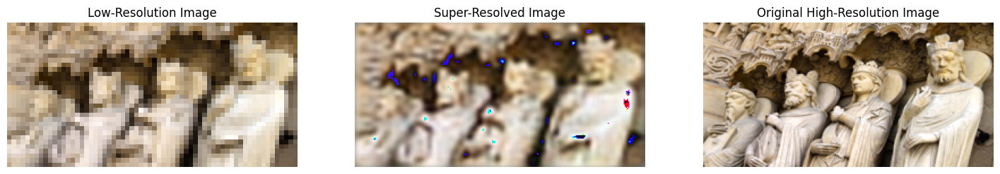

The size of the High-res id: (256, 128)
The size of the Trained-res id: (256, 128)
The size of the Low-res id: (64, 32)


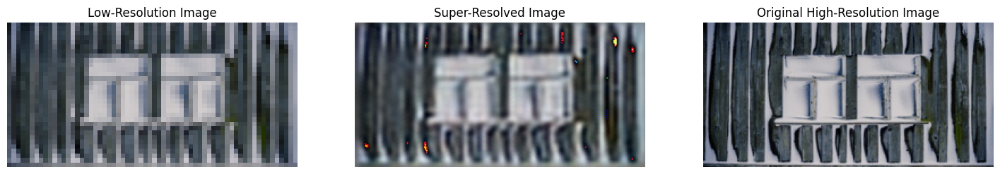

The size of the High-res id: (256, 128)
The size of the Trained-res id: (256, 128)
The size of the Low-res id: (64, 32)


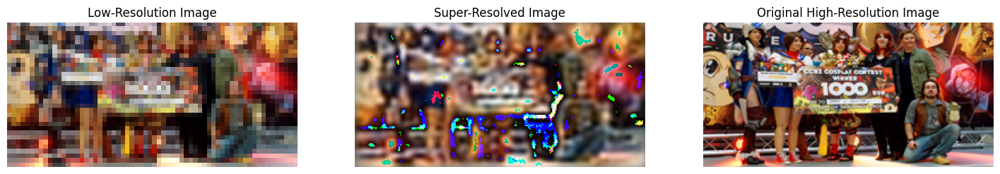

The size of the High-res id: (256, 128)
The size of the Trained-res id: (256, 128)
The size of the Low-res id: (64, 32)


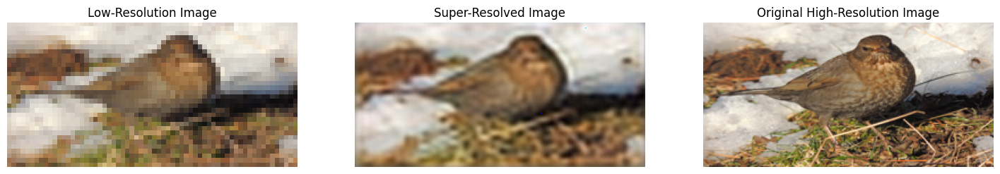

The size of the High-res id: (256, 128)
The size of the Trained-res id: (256, 128)
The size of the Low-res id: (64, 32)


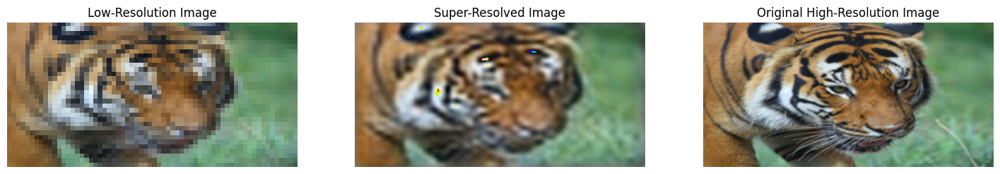

The size of the High-res id: (256, 128)
The size of the Trained-res id: (256, 128)
The size of the Low-res id: (64, 32)


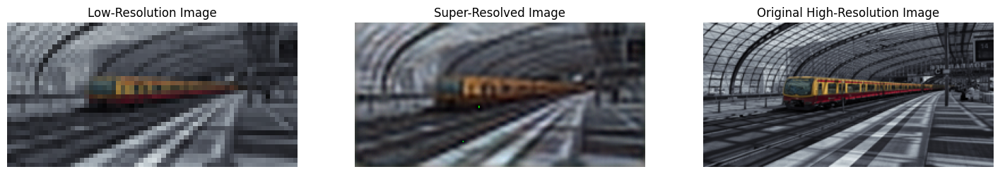

The size of the High-res id: (256, 128)
The size of the Trained-res id: (256, 128)
The size of the Low-res id: (64, 32)


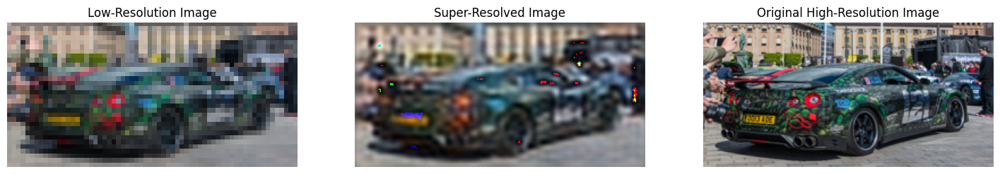

The size of the High-res id: (256, 128)
The size of the Trained-res id: (256, 128)
The size of the Low-res id: (64, 32)


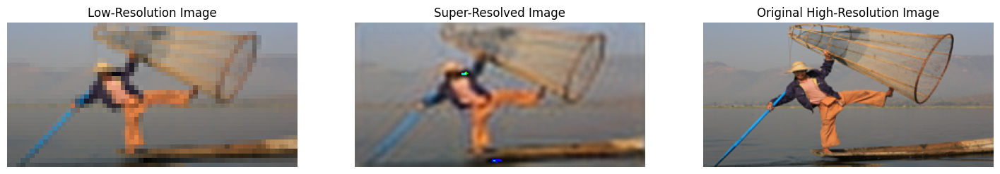

The size of the High-res id: (256, 128)
The size of the Trained-res id: (256, 128)
The size of the Low-res id: (64, 32)


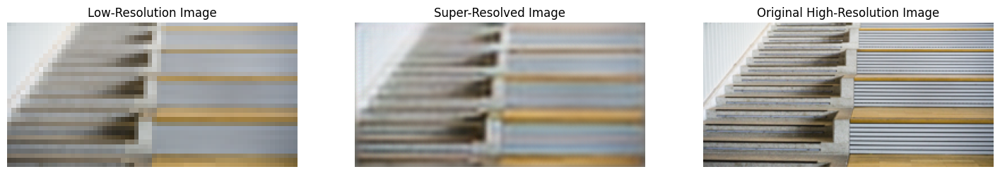

The size of the High-res id: (256, 128)
The size of the Trained-res id: (256, 128)
The size of the Low-res id: (64, 32)


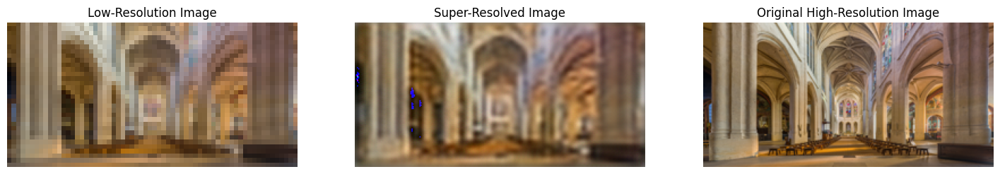

The size of the High-res id: (256, 128)
The size of the Trained-res id: (256, 128)
The size of the Low-res id: (64, 32)


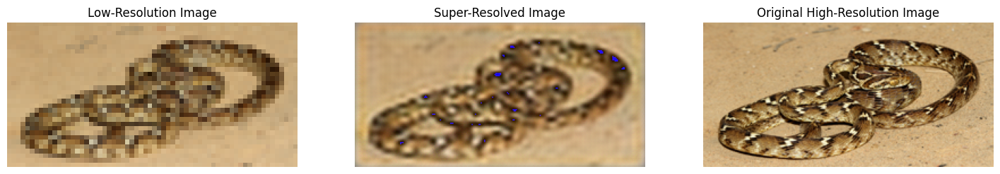

The size of the High-res id: (256, 128)
The size of the Trained-res id: (256, 128)
The size of the Low-res id: (64, 32)


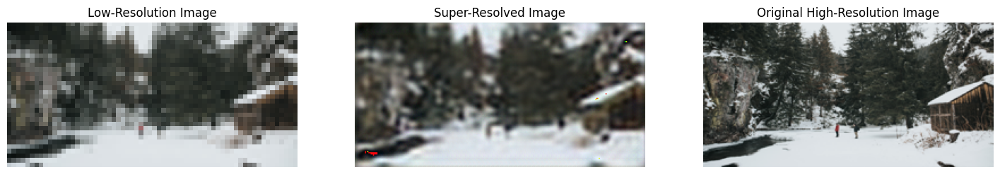

The size of the High-res id: (256, 128)
The size of the Trained-res id: (256, 128)
The size of the Low-res id: (64, 32)


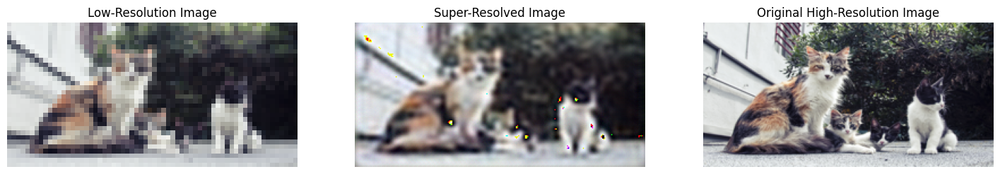

In [ ]:
def display_comparison(model, test_loader, device='mps', num_images=3):
    # Set the model to evaluation mode
    model.eval()

    # Define an inverse transform to undo normalization
    inverse_transform = T.Compose([
        T.Normalize(mean=[-0.5 / 0.5, -0.5 / 0.5, -0.5 / 0.5], std=[1 / 0.5, 1 / 0.5, 1 / 0.5]),
        T.ToPILImage()
    ])

    # Process the first few images from the test loader
    with torch.no_grad():
        for i, (lr_imgs, hr_imgs) in enumerate(test_loader):
            if i >= num_images:
                break

            # Move images to the appropriate device
            lr_imgs, hr_imgs = lr_imgs.to(device), hr_imgs.to(device)

            # Generate the super-resolved image using the model
            sr_imgs = model(lr_imgs)

            # Loop through the batch
            for j in range(lr_imgs.size(0)):
                # Get the images
                lr_image = lr_imgs[j].cpu()
                sr_image = sr_imgs[j].cpu()
                hr_image = hr_imgs[j].cpu()

                # Undo normalization and convert back to PIL
                lr_image_pil = inverse_transform(lr_image)
                sr_image_pil = inverse_transform(sr_image)
                hr_image_pil = inverse_transform(hr_image)
                print(f'The size of the High-res id: {hr_image_pil.size}')
                print(f'The size of the Trained-res id: {sr_image_pil.size}')
                print(f'The size of the Low-res id: {lr_image_pil.size}')
                # Display the images side by side
                plt.figure(figsize=(18, 6))

                plt.subplot(1, 3, 1)
                plt.title('Low-Resolution Image')
                plt.imshow(lr_image_pil)
                plt.axis('off')

                plt.subplot(1, 3, 2)
                plt.title('Super-Resolved Image')
                plt.imshow(sr_image_pil)
                plt.axis('off')

                plt.subplot(1, 3, 3)
                plt.title('Original High-Resolution Image')
                plt.imshow(hr_image_pil)
                plt.axis('off')

                plt.show()

# Example usage:
display_comparison(trained_generator, test_loader, device=device, num_images=3)